# Packages

In [1]:
library(xts)
library(zoo)
library(PerformanceAnalytics)
library(PortfolioAnalytics)
library(RiskPortfolios)
library(covRobust)
library(quantmod)
library(tidyverse)
library(dplyr)
library(ggplot2)
library(readxl)
library(ROI)
library(ROI.plugin.quadprog)
library(ROI.plugin.glpk)
library(plotly)

Carregando pacotes exigidos: zoo


Attaching package: ‘zoo’


The following objects are masked from ‘package:base’:

    as.Date, as.Date.numeric



Attaching package: ‘PerformanceAnalytics’


The following object is masked from ‘package:graphics’:

    legend


Carregando pacotes exigidos: foreach

Carregando pacotes exigidos: TTR

Registered S3 method overwritten by 'quantmod':
  method            from
  as.zoo.data.frame zoo 

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.6     ✔ purrr   0.3.4
✔ tibble  3.1.7     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ purrr::accumulate() masks foreach::accumulate()
✖ dplyr::filter()     masks stats::filter()
✖ dplyr::first()      masks xts::first()
✖ dplyr::lag()        masks stats::lag()
✖ dplyr::last()       masks xts::last()
✖ purrr::when()       masks foreach::when(

# Data

### Cripto

* Source : coinmarketcap

In [2]:
ada <- read_excel("Crypto Data/ADA.xlsx")
names(ada)[2:dim(ada)[2]] <- paste("ADA",names(ada)[2:dim(ada)[2]],sep=".")
head(ada)

Date,ADA.Open,ADA.High,ADA.Low,ADA.Close,ADA.Volume,ADA.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.8051,0.8170,0.7424,0.7567,868001173,25539225299
2022-04-29,0.8439,0.8487,0.7937,0.8050,874797260,27161353317
2022-04-28,0.8406,0.8521,0.8277,0.8440,836357358,28485470786
2022-04-27,0.8275,0.8539,0.8226,0.8406,927312593,28360842945
2022-04-26,0.8986,0.9011,0.8210,0.8276,1020049782,27923948978
2022-04-25,0.8864,0.9017,0.8302,0.8987,1139869029,30321103824


In [3]:
bnb <- read_excel("Crypto Data/BNB.xlsx")
names(bnb)[2:dim(bnb)[2]] <- paste("BNB",names(bnb)[2:dim(bnb)[2]],sep=".")
head(bnb)

Date,BNB.Open,BNB.High,BNB.Low,BNB.Close,BNB.Volume,BNB.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,393.00,399.59,377.77,377.77,1467605770,61680787861
2022-04-29,406.64,410.18,390.54,393.06,1928209754,64177999275
2022-04-28,391.44,408.23,388.88,406.72,2116381172,66407717794
2022-04-27,385.56,394.46,384.08,391.45,1512587369,63914091442
2022-04-26,404.27,407.08,382.08,385.48,1671963898,62940507764
2022-04-25,399.13,404.87,383.19,404.35,1910707893,66021090788


In [4]:
btc <- read_excel("Crypto Data/BTC.xlsx")
names(btc)[2:dim(btc)[2]] <- paste("BTC",names(btc)[2:dim(btc)[2]],sep=".")
head(btc)

Date,BTC.Open,BTC.High,BTC.Low,BTC.Close,BTC.Volume,BTC.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,38605.86,38771.21,37697.94,37714.88,23895713731,717596901509
2022-04-29,39768.62,39887.27,38235.54,38609.82,30882994649,734589762490
2022-04-28,39241.43,40269.47,38941.42,39773.83,33903704907,756698317682
2022-04-27,38120.30,39397.92,37997.31,39241.12,30981015184,746531438329
2022-04-26,40448.42,40713.89,37884.99,38117.46,34569088416,725113482674
2022-04-25,39472.61,40491.75,38338.38,40458.31,35445730570,769607056243


In [5]:
doge <- read_excel("Crypto Data/DOGE.xlsx")
names(doge)[2:dim(doge)[2]] <- paste("DOGE",names(doge)[2:dim(doge)[2]],sep=".")
head(doge)

Date,DOGE.Open,DOGE.High,DOGE.Low,DOGE.Close,DOGE.Volume,DOGE.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.1350,0.1365,0.1262,0.1276,916612071,16923138964
2022-04-29,0.1374,0.1446,0.1341,0.1350,1555397213,17914168301
2022-04-28,0.1397,0.1426,0.1361,0.1374,1105137506,18224002850
2022-04-27,0.1378,0.1454,0.1363,0.1397,1765370972,18534076575
2022-04-26,0.1578,0.1653,0.1374,0.1378,4529010503,18277666837
2022-04-25,0.1319,0.1677,0.1239,0.1580,5177823685,20956499548


In [6]:
eth <- read_excel("Crypto Data/ETH.xlsx")
names(eth)[2:dim(eth)[2]] <- paste("ETH",names(eth)[2:dim(eth)[2]],sep=".")
head(eth)

Date,ETH.Open,ETH.High,ETH.Low,ETH.Close,ETH.Volume,ETH.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,2815.53,2836.83,2727.41,2730.19,13520941867,329245687215
2022-04-29,2936.78,2943.45,2782.44,2815.60,18771041399,339508249529
2022-04-28,2888.85,2973.13,2861.82,2936.94,18443524633,354099998307
2022-04-27,2808.65,2911.88,2802.27,2888.93,17419284041,348272874148
2022-04-26,3008.95,3026.42,2786.25,2808.30,19052045399,338514769949
2022-04-25,2922.99,3018.42,2804.51,3009.39,22332690614,362714896494


In [7]:
link <- read_excel("Crypto Data/LINK.xlsx")
names(link)[2:dim(link)[2]] <- paste("LINK",names(link)[2:dim(link)[2]],sep=".")
head(link)

Date,LINK.Open,LINK.High,LINK.Low,LINK.Close,LINK.Volume,LINK.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,11.97,12.22,10.91,11.00,467930975,5135725844
2022-04-29,12.66,12.71,11.91,11.97,402626878,5590228627
2022-04-28,12.73,12.96,12.43,12.66,446769326,5913654685
2022-04-27,12.36,12.76,12.36,12.73,393745748,5946483902
2022-04-26,13.46,13.48,12.27,12.35,423158564,5769705488
2022-04-25,13.29,13.49,12.58,13.46,506454272,6285338112


In [8]:
ltc <- read_excel("Crypto Data/LTC.xlsx")
names(ltc)[2:dim(ltc)[2]] <- paste("LTC",names(ltc)[2:dim(ltc)[2]],sep=".")
head(ltc)

Date,LTC.Open,LTC.High,LTC.Low,LTC.Close,LTC.Volume,LTC.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,100.38,101.41,95.95,96.17,604900808,6749500613
2022-04-29,103.32,104.02,99.04,100.38,861249271,7044371099
2022-04-28,100.54,104.09,100.01,103.32,780434505,7250308769
2022-04-27,98.41,101.74,98.22,100.54,692599516,7054133166
2022-04-26,104.67,105.17,97.59,98.40,702800418,6903743486
2022-04-25,104.62,104.76,99.51,104.69,802054036,7343716368


In [9]:
trx <- read_excel("Crypto Data/TRX.xlsx")
names(trx)[2:dim(trx)[2]] <- paste("TRX",names(trx)[2:dim(trx)[2]],sep=".")
head(trx)

Date,TRX.Open,TRX.High,TRX.Low,TRX.Close,TRX.Volume,TRX.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.06354,0.06516,0.06212,0.06277,1060740399,6377935574
2022-04-29,0.06374,0.06967,0.06298,0.06353,1446734275,6456030378
2022-04-28,0.06321,0.06405,0.06259,0.06375,750546636,6478413481
2022-04-27,0.06193,0.06363,0.06185,0.06322,769914329,6424636973
2022-04-26,0.06532,0.06555,0.06176,0.06192,759564577,6292597775
2022-04-25,0.06570,0.06573,0.06192,0.06533,822895494,6639425674


In [10]:
xlm <- read_excel("Crypto Data/XLM.xlsx")
names(xlm)[2:dim(xlm)[2]] <- paste("XLM",names(xlm)[2:dim(xlm)[2]],sep=".")
head(xlm)

Date,XLM.Open,XLM.High,XLM.Low,XLM.Close,XLM.Volume,XLM.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.1779,0.1812,0.1686,0.1694,228819322,4198092386
2022-04-29,0.1857,0.1873,0.1771,0.1779,240601532,4409784672
2022-04-28,0.1844,0.1884,0.1830,0.1857,250839456,4600490248
2022-04-27,0.1804,0.1865,0.1801,0.1844,258619858,4569556833
2022-04-26,0.1922,0.1924,0.1788,0.1803,299404226,4469743047
2022-04-25,0.1899,0.1929,0.1795,0.1922,326748689,4762366391


In [11]:
xrp <- read_excel("Crypto Data/XRP.xlsx")
names(xrp)[2:dim(xrp)[2]] <- paste("XRP",names(xrp)[2:dim(xrp)[2]],sep=".")
head(xrp)

Date,XRP.Open,XRP.High,XRP.Low,XRP.Close,XRP.Volume,XRP.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.6114,0.6271,0.5816,0.5871,1649221930,28242161687
2022-04-29,0.6443,0.6456,0.6039,0.6114,1962197662,29411859157
2022-04-28,0.6523,0.6553,0.6363,0.6444,1546067106,30997252970
2022-04-27,0.6418,0.6614,0.6404,0.6523,1722422062,31379920579
2022-04-26,0.6943,0.7041,0.6344,0.6417,2160649427,30869089729
2022-04-25,0.6988,0.6989,0.6482,0.6944,2377291271,33405523904


In [12]:
crypto_list <- list(ada,bnb,btc,doge,eth,link,ltc,trx,xlm,xrp)

In [13]:
crypto_dataframe <- crypto_list %>% reduce(full_join,by='Date')

In [14]:
head(crypto_dataframe)

Date,ADA.Open,ADA.High,ADA.Low,ADA.Close,ADA.Volume,ADA.Market Cap,BNB.Open,BNB.High,BNB.Low,⋯,XLM.Low,XLM.Close,XLM.Volume,XLM.Market Cap,XRP.Open,XRP.High,XRP.Low,XRP.Close,XRP.Volume,XRP.Market Cap
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2022-04-30,0.8051,0.8170,0.7424,0.7567,868001173,25539225299,393.00,399.59,377.77,⋯,0.1686,0.1694,228819322,4198092386,0.6114,0.6271,0.5816,0.5871,1649221930,28242161687
2022-04-29,0.8439,0.8487,0.7937,0.8050,874797260,27161353317,406.64,410.18,390.54,⋯,0.1771,0.1779,240601532,4409784672,0.6443,0.6456,0.6039,0.6114,1962197662,29411859157
2022-04-28,0.8406,0.8521,0.8277,0.8440,836357358,28485470786,391.44,408.23,388.88,⋯,0.1830,0.1857,250839456,4600490248,0.6523,0.6553,0.6363,0.6444,1546067106,30997252970
2022-04-27,0.8275,0.8539,0.8226,0.8406,927312593,28360842945,385.56,394.46,384.08,⋯,0.1801,0.1844,258619858,4569556833,0.6418,0.6614,0.6404,0.6523,1722422062,31379920579
2022-04-26,0.8986,0.9011,0.8210,0.8276,1020049782,27923948978,404.27,407.08,382.08,⋯,0.1788,0.1803,299404226,4469743047,0.6943,0.7041,0.6344,0.6417,2160649427,30869089729
2022-04-25,0.8864,0.9017,0.8302,0.8987,1139869029,30321103824,399.13,404.87,383.19,⋯,0.1795,0.1922,326748689,4762366391,0.6988,0.6989,0.6482,0.6944,2377291271,33405523904


In [15]:
crypto_prices <- crypto_dataframe %>% 
    dplyr::select(Date,ends_with("Close")) %>% 
    arrange(Date) %>% 
    rename_with(~str_remove(., '.Close'))

In [16]:
crypto_prices  

Date,ADA,BNB,BTC,DOGE,ETH,LINK,LTC,TRX,XLM,XRP
<dttm>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
2018-01-01,0.7287,8.41,13657.2,0.008909,772.64,0.7336,229.03,0.05169,0.4800,2.39
2018-01-02,0.7826,8.84,14982.1,0.009145,884.44,0.6737,255.68,0.07868,0.5648,2.48
2018-01-03,1.0800,9.54,15201.0,0.009320,962.72,0.6812,245.37,0.09470,0.8962,3.11
2018-01-04,1.1100,9.21,15599.2,0.009644,980.92,0.9844,241.37,0.20800,0.7240,3.20
2018-01-05,0.9996,14.92,17429.5,0.012170,997.72,0.9075,249.27,0.22060,0.6627,3.05
2018-01-06,1.0300,22.76,17527.0,0.014860,1041.68,1.0600,296.45,0.17480,0.7099,3.09
2018-01-07,1.0100,18.66,16477.6,0.017090,1153.17,1.2700,288.45,0.19970,0.6996,3.38
2018-01-08,0.8990,18.26,15170.1,0.015050,1148.53,1.3800,255.76,0.15200,0.6293,2.46
2018-01-09,0.8147,17.41,14595.4,0.013420,1299.74,1.2300,247.04,0.12480,0.5857,2.10


In [17]:
crypto_prices$Date <- as.POSIXct(crypto_prices$Date)

In [18]:
crypto_prices_xts <- xts(as.data.frame(crypto_prices[,-1]),order.by=crypto_prices$Date)

In [19]:
crypto_returns <- Return.calculate(crypto_prices_xts)

* Source : yahoo finance

### Other financial assets data

* Source : yahoo finance

In [20]:
#bova11 <- quantmod::getSymbols("BOVA11.SA",from="2018-01-01",to='2022-04-30',auto.assign=FALSE)
#IVVB11 <- quantmod::getSymbols("IVVB11.SA",from="2018-01-01",to='2022-04-30',auto.assign=FALSE)

## Data available after 2020 for these ETFs 
#gold11 <- quantmod::getSymbols("GOLD11.SA",from="2018-01-01",to='2022-04-30',auto.assign=FALSE) 
#XFIX11 <- quantmod::getSymbols("XFIX11.SA",from="2018-01-01",to='2022-04-30',auto.assign=FALSE)


* Source : economática

In [21]:
trad_assets <- read_excel("Other Assets Data/index.xlsx") %>% 
    arrange(Date) %>% 
    rename_with(~str_remove(., '.Close')) 

In [22]:
trad_assets <- trad_assets %>% drop_na()

In [23]:
trad_assets[,-1] <- lapply(trad_assets[,-1], FUN = function(y){as.numeric(y)})

Warning message in FUN(X[[i]], ...):
“NAs introduzidos por coerção”
Warning message in FUN(X[[i]], ...):
“NAs introduzidos por coerção”
Warning message in FUN(X[[i]], ...):
“NAs introduzidos por coerção”
Warning message in FUN(X[[i]], ...):
“NAs introduzidos por coerção”
Warning message in FUN(X[[i]], ...):
“NAs introduzidos por coerção”


In [24]:
trad_assets$Date <- as.POSIXct(trad_assets$Date)

In [25]:
trad_assets_xts <- xts(as.data.frame(trad_assets[,-1]),order.by=trad_assets$Date)

In [26]:
head(trad_assets_xts)

Warning message:
“timezone of object (UTC) is different than current timezone ().”


            OURO    IFIX     IBOV IVVB11     IMAG
2018-01-01    NA      NA       NA     NA       NA
2018-01-02 136.3 2238.05 77891.04  92.12 4797.595
2018-01-03 136.0 2247.45 77995.16  92.10 4804.408
2018-01-04 135.9 2248.29 78647.42  92.42 4808.951
2018-01-05 136.7 2244.81 79071.47  92.80 4807.172
2018-01-08 135.4 2242.59 79378.54  93.36 4812.208

In [27]:
trad_assets_returns <- Return.calculate(trad_assets_xts)

# Composition of portfolios

In [28]:
crypto_returns <- na.omit(crypto_returns)

In [29]:
trad_assets_returns <- na.omit(trad_assets_returns)
trad_assets_returns <- trad_assets_returns[index(trad_assets_returns) <= "2022-04-30"]

In [30]:
# trad_and_crypto <- na.omit(merge(trad_assets_returns, crypto_returns,fill=na.locf))
trad_and_crypto <- na.omit(merge(trad_assets_returns, crypto_returns, join='left'))

In [31]:
#trad_and_btc <- na.omit(merge(trad_assets_returns, crypto_returns$BTC,fill=na.locf))

In [32]:
#all_portfolios <- list(crypto_returns,trad_assets_returns,trad_and_btc,trad_and_crypto)

In [33]:
#Testing: garanteing every portfolio has the same dimensions

trad_assets_returns <- trad_and_crypto[,c('OURO','IFIX','IBOV','IVVB11','IMAG')]

print(dim(trad_assets_returns))

crypto_returns <- trad_and_crypto[,c('ADA','BNB','BTC','DOGE','ETH','LINK','LTC','TRX','XLM','XRP')]
print(dim(crypto_returns))

trad_and_btc <- trad_and_crypto[,c('OURO','IFIX','IBOV','IVVB11','IMAG',"BTC")]

print(dim(trad_and_btc))

#all_portfolios <- list(crypto_returns, trad_assets_returns, trad_and_btc, trad_and_crypto)

[1] 1012    5
[1] 1012   10
[1] 1012    6


In [37]:
class(ass)

[1] "OURO"   "IFIX"   "IBOV"   "IVVB11" "IMAG"   "ADA"    "BNB"    "BTC"   
 [9] "DOGE"   "ETH"    "LINK"   "LTC"    "TRX"    "XLM"    "XRP"

In [38]:
write.zoo(trad_and_crypto,'portfolio.csv',sep=",")

# Computing optimal portfolios

### Base bench marks

In [34]:
## OLD CODE

compute_equal_weights <- function(R,type_assets,rebal){

    # Create a vector of equal weights
    equal_weights <- rep(1 / ncol(R), ncol(R))

    # Compute the benchmark returns
    r_benchmark <- Return.portfolio(R = R, weights = equal_weights, rebalance_on = rebal)

    if(is.na(rebal)){
        name_bench <- paste(type_assets,"NA", sep = "_")
    }else {
       name_bench <- paste(type_assets,rebal, sep = "_")
    }
    colnames(r_benchmark) <- name_bench

    return(r_benchmark)


}


rebalancing_periods <- c("years", "quarters", "months", "weeks", "days")


crypto_only_EW <- compute_equal_weights(crypto_returns,"crypto_only_EW",NA)
for (period in rebalancing_periods){
    port_EW <- compute_equal_weights(crypto_returns,"crypto_only_EW",period)
    crypto_only_EW <- merge(crypto_only_EW,port_EW)
}


trad_only_EW <- compute_equal_weights(trad_assets_returns,"trad_only",NA)
for (period in rebalancing_periods){
    port_EW <- compute_equal_weights(trad_assets_returns,"trad_only",period)
    trad_only_EW <- merge(trad_only_EW,port_EW)
}

trad_and_btc_EW <- compute_equal_weights(trad_and_btc,"trad_and_btc_EW",NA)
for (period in rebalancing_periods){
    port_EW <- compute_equal_weights(trad_and_btc,"trad_and_btc_EW",period)
    trad_and_btc_EW <- merge(trad_and_btc_EW,port_EW)
}

trad_and_crypto_EW <- compute_equal_weights(trad_and_crypto,"trad_and_crypto_EW",NA)
for (period in rebalancing_periods){
    port_EW <- compute_equal_weights(trad_and_crypto,"trad_and_crypto_EW",period)
    trad_and_crypto_EW <- merge(trad_and_crypto_EW,port_EW)
}



In [60]:
table.AnnualizedReturns(trad_and_crypto_EW )

,trad_and_crypto_EW_NA,trad_and_crypto_EW_years,trad_and_crypto_EW_quarters,trad_and_crypto_EW_months,trad_and_crypto_EW_weeks,trad_and_crypto_EW_days
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Annualized Return,0.4181,0.7434,0.5421,0.4832,0.4486,0.4079
Annualized Std Dev,0.6765,0.7216,0.6207,0.5746,0.5697,0.5690
Annualized Sharpe (Rf=0%),0.6181,1.0303,0.8735,0.8409,0.7875,0.7170


In [77]:
head(trad_and_crypto)

Warning message:
“timezone of object (UTC) is different than current timezone ().”


                    OURO          IFIX         IBOV        IVVB11          IMAG
2018-01-03 -0.0022010271  0.0042000849  0.001336739 -0.0002171081  0.0014201007
2018-01-04 -0.0007352941  0.0003737569  0.008362827  0.0034744843  0.0009454630
2018-01-05  0.0058866814 -0.0015478430  0.005391785  0.0041116641 -0.0003699150
2018-01-08 -0.0095098756 -0.0009889478  0.003883449  0.0060344828  0.0010477785
2018-01-09  0.0044313146 -0.0007402156 -0.006487900  0.0063196230  0.0002898943
2018-01-10  0.0036764706  0.0011066834 -0.008406546 -0.0071314529  0.0010870492
                   ADA          BNB         BTC        DOGE          ETH
2018-01-03  0.38001533  0.079185520  0.01461077  0.01913614  0.088507982
2018-01-04  0.02777778 -0.034591195  0.02619565  0.03476395  0.018904770
2018-01-05 -0.09945946  0.619978284  0.11733294  0.26192451  0.017126779
2018-01-08 -0.10990099 -0.021436227 -0.07935015 -0.11936805 -0.004023691
2018-01-09 -0.09377086 -0.046549836 -0.03788373 -0.10830565  0.131655246
20

### Base portfolio I
* Full investment
* Long only
* No size constraints

In [35]:
visualizing_EF <- function(R, p, EF, n_permut=50000){

    meanReturns <- colMeans(R)
    covMat <- cov(R)

    randomport<- random_portfolios(p, permutations = n_permut, rp_method = "sample")

    minvar.port <- add.objective(p, type = "risk", name = "var")
 
    # Optimize
    minvar.opt <- optimize.portfolio(R, minvar.port, optimize_method = "random", 
                                    rp = randomport)
    
    # Generate maximum return portfolio
    maxret.port <- add.objective(p, type = "return", name = "mean")
    
    # Optimize
    maxret.opt <- optimize.portfolio(R, maxret.port, optimize_method = "random", 
                                    rp = randomport)

    minret <- min(meanReturns)
    maxret <- max(meanReturns)


    
    
    feasible.sd <- apply(randomport, 1, function(x){
        return(sqrt(matrix(x, nrow = 1) %*% covMat %*% matrix(x, ncol = 1)))
        })

    feasible.means <- apply(randomport, 1, function(x){
        return(x %*% meanReturns)
        })
    
    feasible.sr <- feasible.means / feasible.sd


    eff.frontier <- data.frame("Risk" = as.vector(EF[,2]), "Return" = as.vector(EF[,1]))
    EF_plot <-  plot_ly() %>%

    add_trace(x = feasible.sd, y = feasible.means, color = feasible.sr, 
            mode = "markers", type = "scattergl", showlegend = F,
            
            marker = list(size = 3, opacity = 0.5, 
                        colorbar = list(title = "Sharpe Ratio"))) %>%
    
    add_trace(data = eff.frontier , x = ~Risk, y = ~Return,mode = "lines", type = "scatter")%>% 
    layout(title = "Efficient Frontier",
            # yaxis = list(title = "Mean Returns", tickformat = ".2%"),
            # xaxis = list(title = "Standard Deviation", tickformat = ".2%")

            yaxis = list(title = "Mean Returns"),
            xaxis = list(title = "Standard Deviation")
            
            )
    
    return(EF_plot)
    


}

In [36]:
# Portfolio with only crypto

crypto_base_spec_I <- portfolio.spec(assets =  colnames(crypto_returns))

crypto_base_spec_I <- add.constraint(portfolio = crypto_base_spec_I, type = "full_investment")

crypto_base_spec_I <- add.constraint(portfolio = crypto_base_spec_I, type = "long_only")


# Efficient Frontier Crypto Only:

MV_EF_crypto_only = meanvar.efficient.frontier(portfolio = crypto_base_spec_I, crypto_returns, n.portfolios = 1000)

Warning message:
“executing %dopar% sequentially: no parallel backend registered”


In [37]:
visualizing_EF(crypto_returns,crypto_base_spec_I,MV_EF_crypto_only)

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



HTML widgets cannot be represented in plain text (need html)

In [38]:
# Portfolio with only traditional assets

trad_base_spec_I <- portfolio.spec(assets =  colnames(trad_assets_returns))

trad_base_spec_I <- add.constraint(portfolio = trad_base_spec_I, type = "full_investment")

trad_base_spec_I <- add.constraint(portfolio = trad_base_spec_I, type = "long_only")

MV_EF_trad = meanvar.efficient.frontier(portfolio = trad_base_spec_I, trad_assets_returns, n.portfolios = 1000)

In [39]:
visualizing_EF(trad_assets_returns,trad_base_spec_I,MV_EF_trad)

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



HTML widgets cannot be represented in plain text (need html)

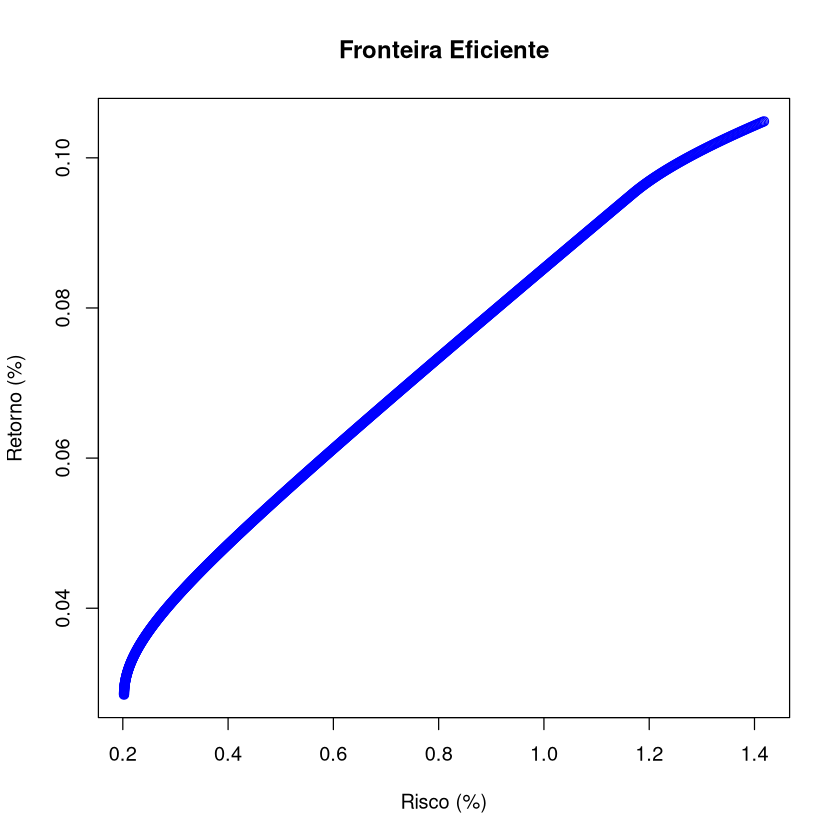

In [40]:
plot(100*MV_EF_trad[,2],100*MV_EF_trad[,1],xlab="Risco (%)",ylab = "Retorno (%)",col="blue",main = "Fronteira Eficiente")

In [41]:
# Portfolio with only traditional assets and bitcoin

trad_and_BTC_base_spec_I <- portfolio.spec(assets =  colnames(trad_and_btc))

trad_and_BTC_base_spec_I <- add.constraint(portfolio = trad_and_BTC_base_spec_I, type = "full_investment")

trad_and_BTC_base_spec_I <- add.constraint(portfolio = trad_and_BTC_base_spec_I, type = "long_only")

MV_EF_trad_and_BTC = meanvar.efficient.frontier(portfolio = trad_and_BTC_base_spec_I, trad_and_btc, n.portfolios = 1000)

In [42]:
visualizing_EF(trad_and_btc, trad_and_BTC_base_spec_I, MV_EF_trad_and_BTC )

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



HTML widgets cannot be represented in plain text (need html)

In [43]:
# Portfolio with only traditional assets and crypto

trad_and_crypto_base_spec_I <- portfolio.spec(assets =  colnames(trad_and_crypto))

trad_and_crypto_base_spec_I <- add.constraint(portfolio = trad_and_crypto_base_spec_I, type = "full_investment")

trad_and_crypto_base_spec_I <- add.constraint(portfolio = trad_and_crypto_base_spec_I, type = "long_only")

MV_EF_trad_and_crypto = meanvar.efficient.frontier(portfolio = trad_and_crypto_base_spec_I, trad_and_crypto, n.portfolios = 1000)

In [44]:
visualizing_EF(trad_and_crypto, trad_and_crypto_base_spec_I ,MV_EF_trad_and_crypto)

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



HTML widgets cannot be represented in plain text (need html)

In [45]:
frontier_to_DF <- function(EF) {
     eff.frontier <- data.frame("Risk" = as.vector(EF[,2]), "Return" = as.vector(EF[,1]))

     return(eff.frontier)

}

In [46]:
plot_ly() %>%

    add_trace(data = frontier_to_DF(MV_EF_trad_and_crypto) , x = ~Risk, y = ~Return,mode = "lines", type = "scatter",text='trad_and_crypto')%>% 
    add_trace(data = frontier_to_DF(MV_EF_crypto_only) , x = ~Risk, y = ~Return,mode = "lines", type = "scatter",text='crypto_only')%>% 
    add_trace(data = frontier_to_DF(MV_EF_trad) , x = ~Risk, y = ~Return,mode = "lines", type = "scatter",text='trad')%>% 
    add_trace(data = frontier_to_DF(MV_EF_trad_and_BTC) , x = ~Risk, y = ~Return,mode = "lines", type = "scatter",text='trad_and_BTC')%>% 
    
    
    layout(title = "Efficient Frontier",  yaxis = list(title = "Mean Returns"), xaxis = list(title = "Standard Deviation")) 

HTML widgets cannot be represented in plain text (need html)

* Adding objectives  minimize StdDev

In [47]:

#crypto only
crypto_base_spec_I <- add.objective(crypto_base_spec_I,type = "return", name = "mean")
crypto_base_spec_I <- add.objective(crypto_base_spec_I,type = "risk", name = "StdDev")

opt_crypto_I <- optimize.portfolio(crypto_returns, 
                                crypto_base_spec_I, 
                                optimize_method='random',
                                trace=TRUE)


Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



In [48]:

#trad
trad_base_spec_I <- add.objective(trad_base_spec_I,type = "return", name = "mean")
trad_base_spec_I <- add.objective(trad_base_spec_I,type = "risk", name = "StdDev")

opt_trad_I <- optimize.portfolio(trad_assets_returns, 
                                trad_base_spec_I, 
                                optimize_method='random',
                                trace=TRUE)

Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



In [49]:

#trad and btc
trad_and_BTC_base_spec_I <- add.objective(trad_and_BTC_base_spec_I,type = "return", name = "mean")
trad_and_BTC_base_spec_I <- add.objective(trad_and_BTC_base_spec_I,type = "risk", name = "StdDev")

opt_trad_and_btc_I <- optimize.portfolio(trad_and_btc, 
                                trad_and_BTC_base_spec_I, 
                                optimize_method='random',
                                trace=TRUE)


Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



In [50]:


#trad and crypto
trad_and_crypto_base_spec_I <- add.objective(trad_and_crypto_base_spec_I,type = "return", name = "mean")
trad_and_crypto_base_spec_I <- add.objective(trad_and_crypto_base_spec_I,type = "risk", name = "StdDev")

opt_trad_and_crypto_I <- optimize.portfolio(trad_and_crypto, 
                                trad_and_crypto_base_spec_I, 
                                optimize_method='random',
                                trace=TRUE)


Leverage constraint min_sum and max_sum are restrictive, 
              consider relaxing. e.g. 'full_investment' constraint should be min_sum=0.99 and max_sum=1.01



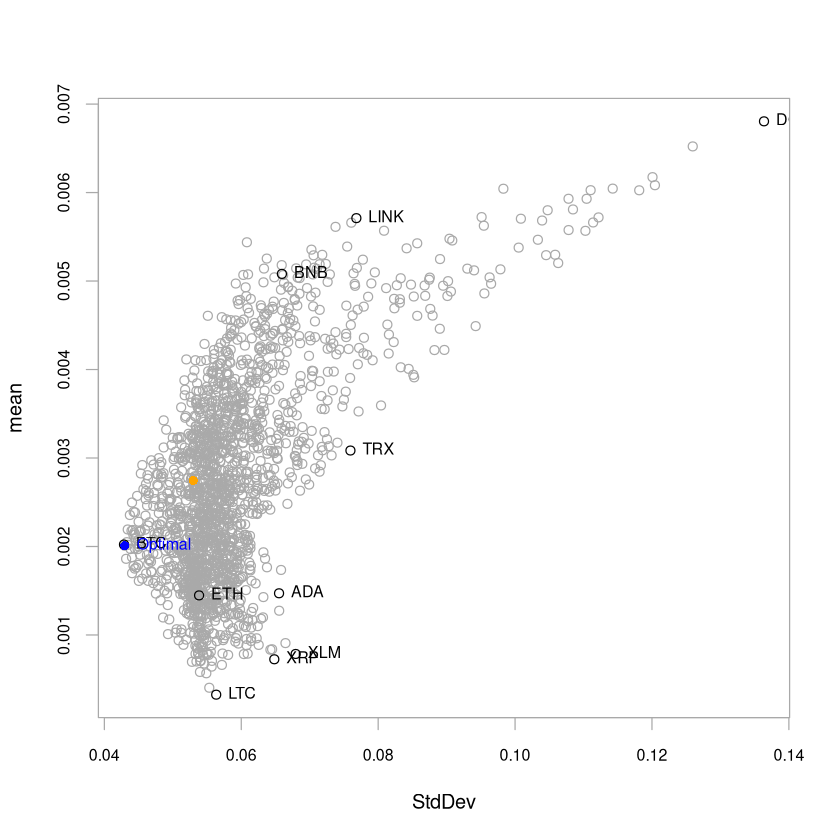

In [51]:
chart.RiskReward(opt_crypto_I,risk.col = "StdDev",return.col = "mean",chart.assets = TRUE)

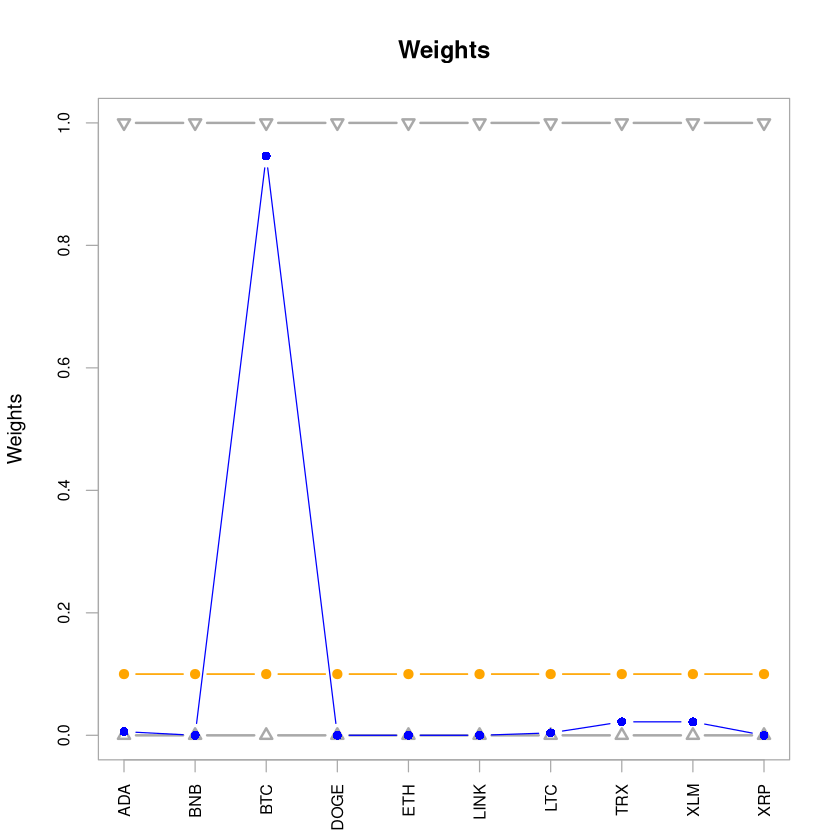

In [52]:
chart.Weights(opt_crypto_I)

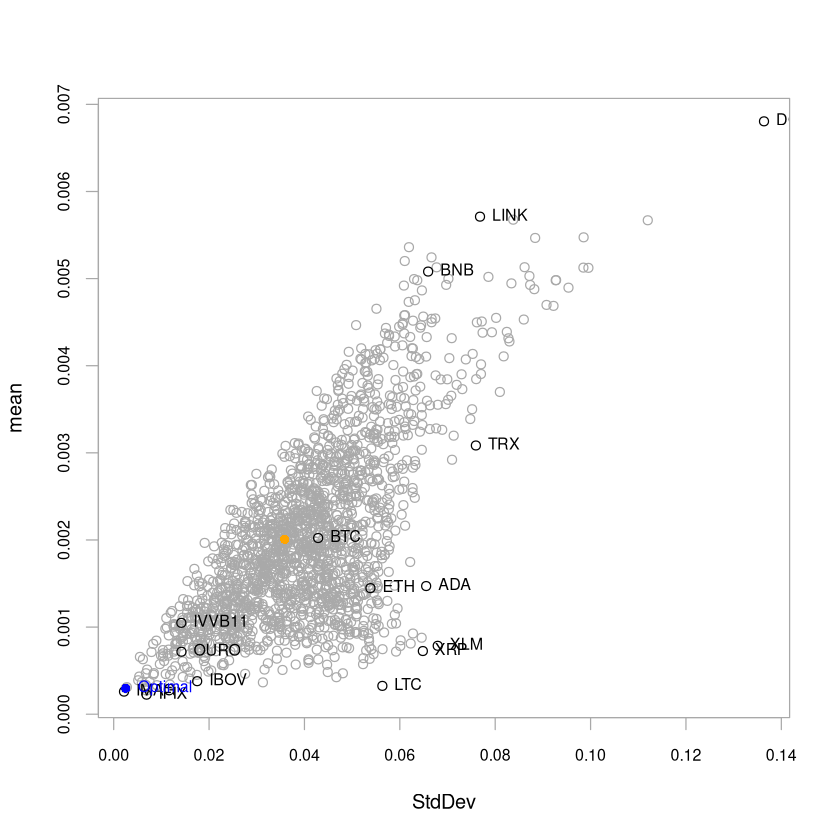

In [53]:
chart.RiskReward(opt_trad_and_crypto_I,risk.col = "StdDev",return.col = "mean",chart.assets = TRUE)

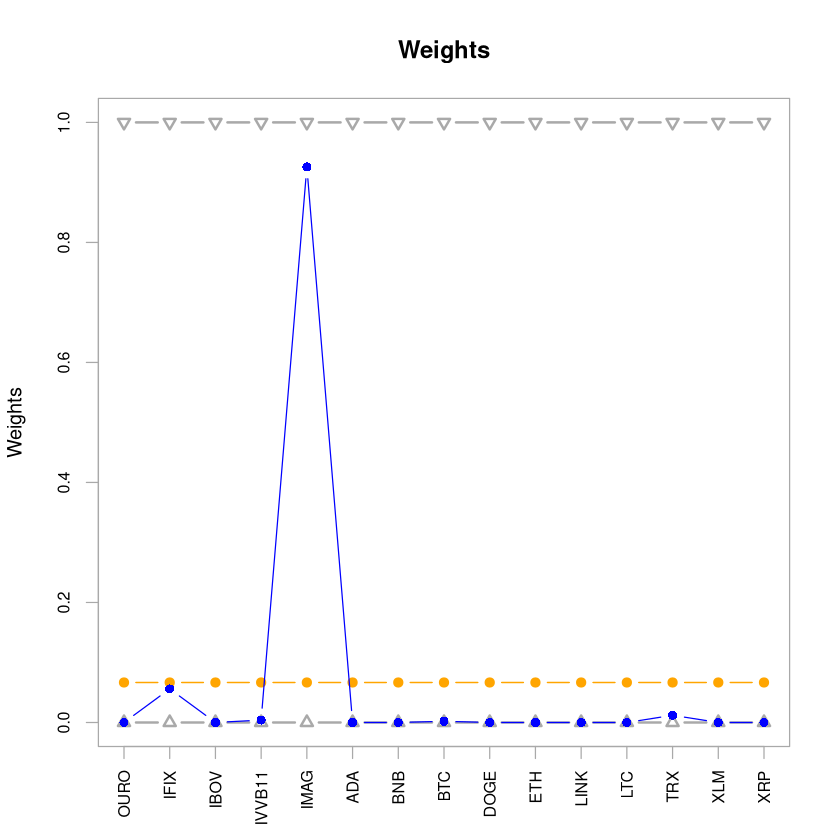

In [54]:
chart.Weights(opt_trad_and_crypto_I)

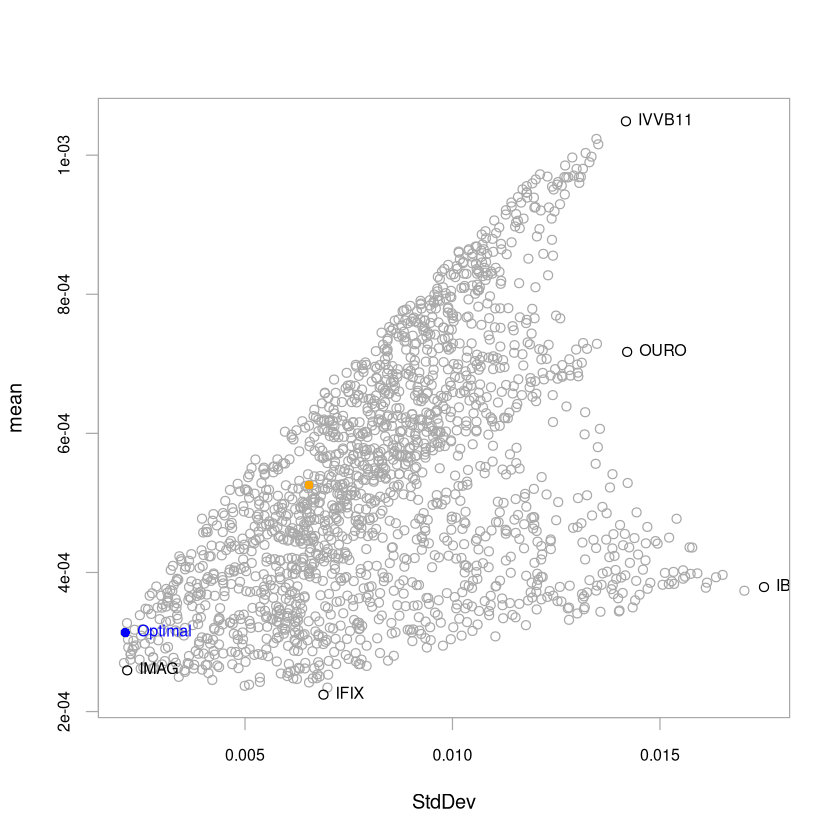

In [55]:
chart.RiskReward(opt_trad_I,risk.col = "StdDev",return.col = "mean",chart.assets = TRUE)

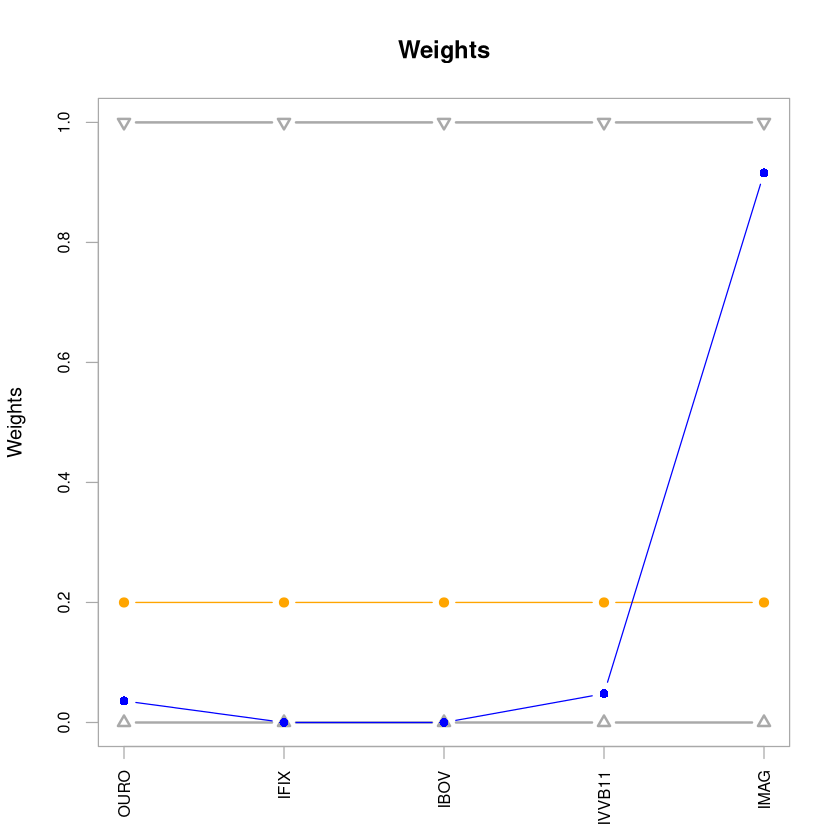

In [56]:
chart.Weights(opt_trad_I)

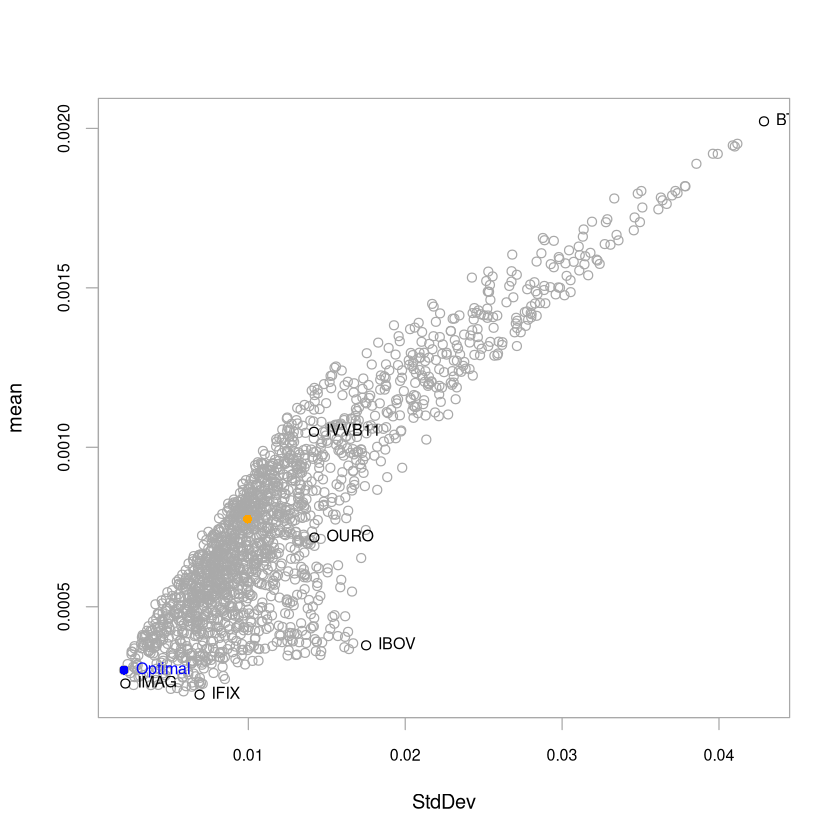

In [57]:
chart.RiskReward(opt_trad_and_btc_I,risk.col = "StdDev",return.col = "mean",chart.assets = TRUE)

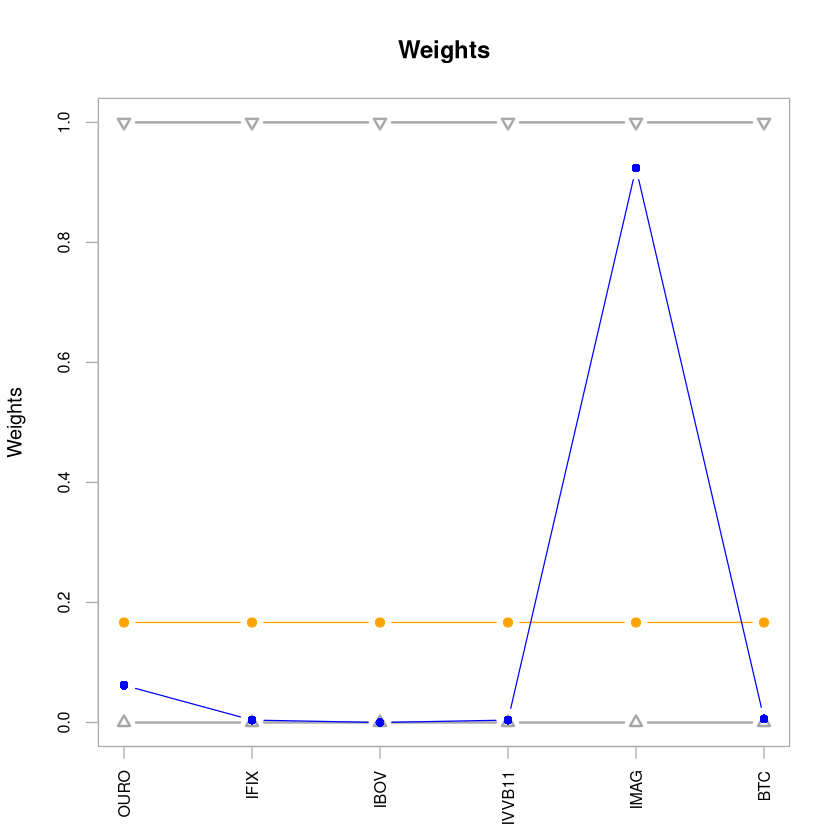

In [58]:
chart.Weights(opt_trad_and_btc_I)

In [64]:
class(covEstimation(crypto_returns,control=list(type="ewma")))

[1] "matrix" "array"

In [74]:
str(covEstimation(crypto_returns,control=list(type="ewma")))

 num [1:10, 1:10] 0.00226 0.00131 0.00128 0.002 0.00151 ...
 - attr(*, "dimnames")=List of 2
  ..$ : chr [1:10] "ADA" "BNB" "BTC" "DOGE" ...
  ..$ : chr [1:10] "ADA" "BNB" "BTC" "DOGE" ...


NULL

In [67]:
custom_fun <- function(R, p,cov = "ewma"){
    out <- list()
    out$sigma <- covEstimation(R,control=list(type=cov))
    return(out)
}

In [76]:
# optimize.portfolio(trad_and_crypto, 
#                                 trad_and_crypto_base_spec_I, 
#                                 optimize_method='random',
#                                 trace=TRUE,momentFUN=custom_fun)

----

### Base portfolio II
* Full investment
* Short allowed
* No constraints about the size

----

